In [6]:
import cv2
import numpy as np 
from google.colab.patches import cv2_imshow

#get image classifiers
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier('haarcascade_eye.xml')

In [7]:
#read image
joker = cv2.imread('joker.png')
joker_2 = cv2.imread('pngegg.png')
dog = cv2.imread('PngItem_433039.png')
jmask = cv2.imread('Mask.png')
sample = cv2.imread('Sample.jpg')

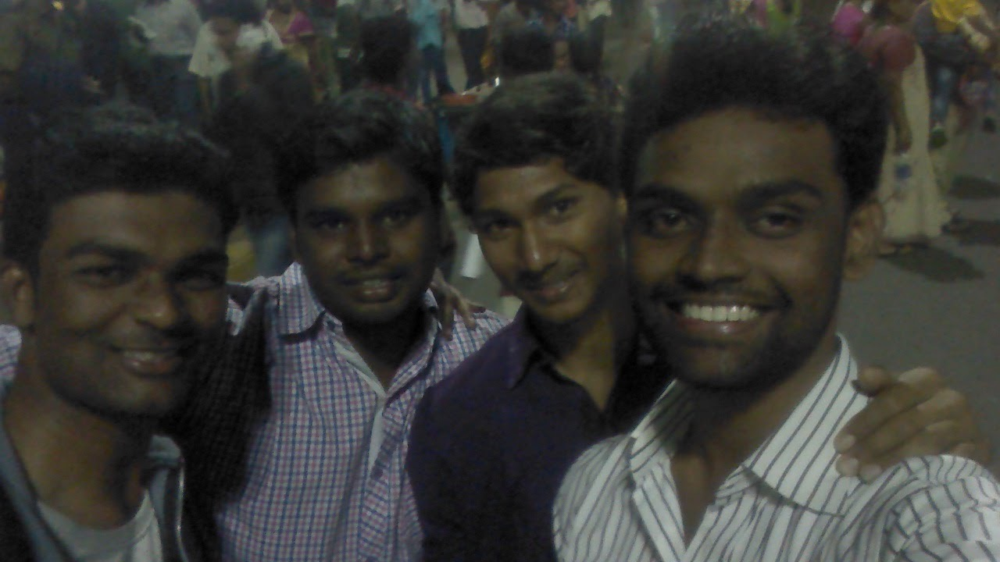

In [10]:
# Display the original image
cv2_imshow(sample)

In [8]:
from cv2 import dnn_superres

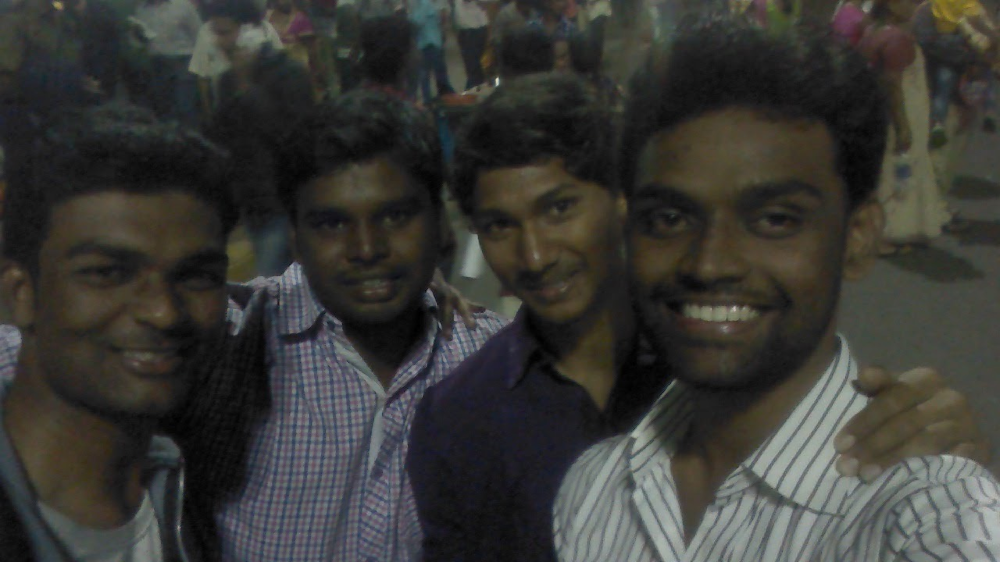

In [24]:
# Create an SuperResolution object
sr = dnn_superres.DnnSuperResImpl_create()

# Read the EDSR pre-trained model
path = "EDSR_x3.pb"
sr.readModel(path)

# Set the EDSR model and scale to get correct pre- and post-processing
sr.setModel("edsr", 3)

# Upscale the image
result = sr.upsample(sample)

# Display the result
cv2_imshow(result)

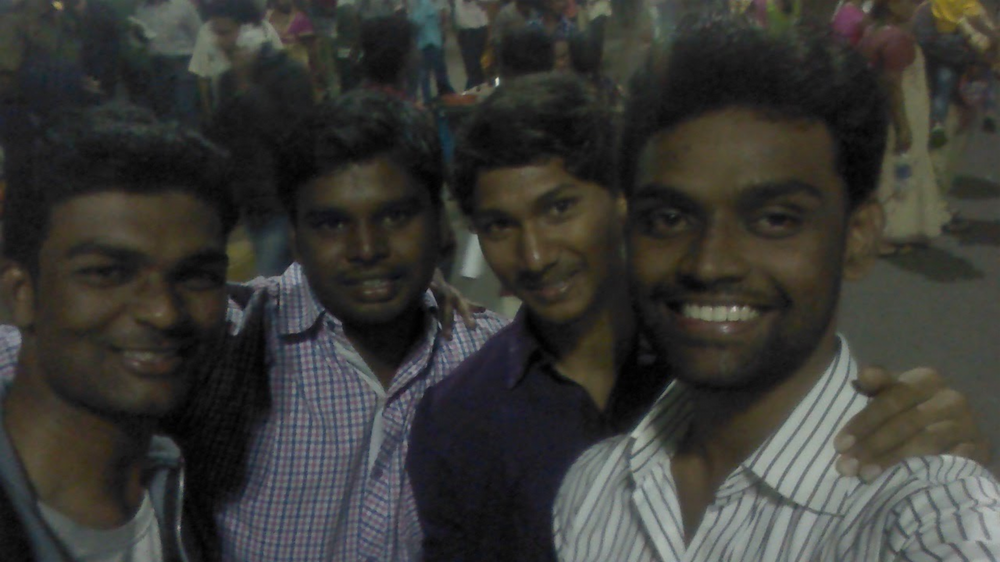

In [11]:
# Read the FSRCNN pre-trained model
path1 = "FSRCNN-small_x4.pb"
sr.readModel(path1)

# Set the FSRCNN model and scale to get correct pre- and post-processing
sr.setModel("fsrcnn", 4)

# Upscale the image
result1 = sr.upsample(sample)

# Display the result
cv2_imshow(result1)

In [27]:
finalimage = result
#get shape of filter being applied
original_filter_h,original_filter_w,filter_channels = dog.shape

#get shape of image to be modified
img_h,img_w,img_channels = result.shape

#convert to gray
img_gray = cv2.cvtColor(result, cv2.COLOR_BGR2GRAY)
filter_gray = cv2.cvtColor(dog, cv2.COLOR_BGR2GRAY)

#create mask and inverse mask of filter
#Note: Used THRESH_BINARY_INV because the image was on transparent background
ret, originmask = cv2.threshold(filter_gray, 10, 255, cv2.THRESH_BINARY_INV)
originmaskinvert = cv2.bitwise_not(originmask)

#find faces in image using classifier
faces = face_cascade.detectMultiScale(img_gray, 1.3, 5)

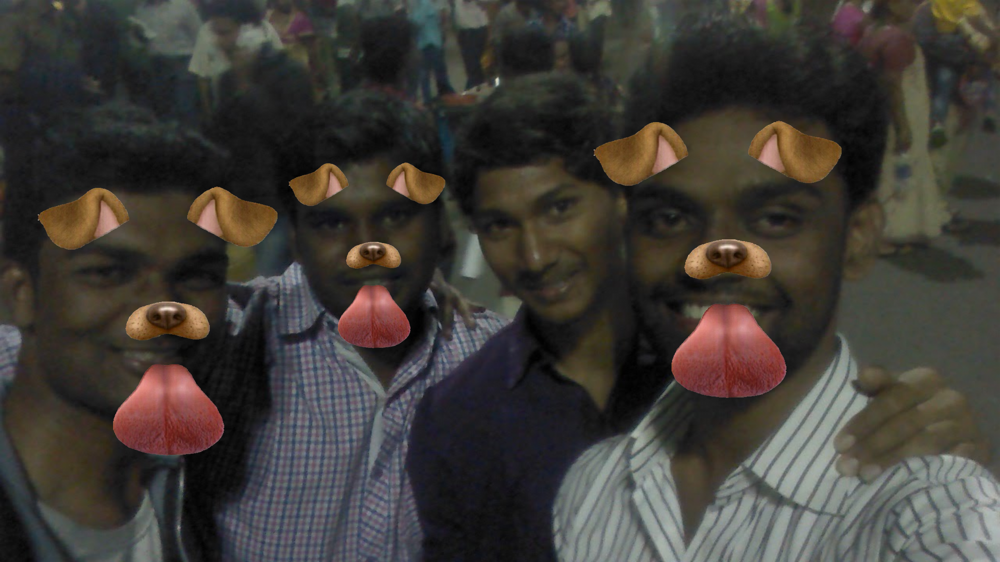

In [28]:
#looping to detect multiple faces
for (x,y,w,h) in faces:

    #coordinates of face region
    face_w = w
    face_h = h
    face_x1 = x
    face_x2 = face_x1 + face_w
    face_y1 = y
    face_y2 = face_y1 + face_h

    #filter size in relation to face by scaling
    filter_width = int(face_w) + 20
    filter_height = int(face_h) + 100
    
    #setting location of coordinates of filter
    filter_x1 = face_x1 -10
    filter_x2 = filter_x1 + filter_width +10
    filter_y1 = face_y1 + 10
    filter_y2 = filter_y1 + filter_height + 80

    #To make sure the filter coordinates are within the image boundaries
    if filter_x1 < 0:
        filter_x1 = 0
    if filter_y1 < 0:
        filter_y1 = 0
    if filter_x2 > img_w:
        filter_x2 = img_w
    if filter_y2 > img_h:
        filter_y2 = img_h

    #After validation
    filter_width = filter_x2 - filter_x1
    filter_height = filter_y2 - filter_y1

    #resize filter to fit on face
    filter = cv2.resize(dog, (filter_width,filter_height), interpolation = cv2.INTER_AREA)
    mask = cv2.resize(originmask, (filter_width,filter_height), interpolation = cv2.INTER_AREA)
    maskinvert = cv2.resize(originmaskinvert, (filter_width,filter_height), interpolation = cv2.INTER_AREA)

    #take ROI for filter from background that is equal to size of filter image
    roi = result[filter_y1:filter_y2, filter_x1:filter_x2]

    #original image in background where filter is not present
    roi_bg = cv2.bitwise_and(roi,roi,mask = mask)
    roi_fg = cv2.bitwise_and(filter,filter,mask=maskinvert)
    filteredface = cv2.add(roi_bg,roi_fg)

    #put back in original image
    finalimage[filter_y1:filter_y2, filter_x1:filter_x2] = filteredface

#display the final image with all faces applied filter
cv2_imshow(finalimage) 
